## Experiment 1-  Is it really learning actions ? 
Author : @leopauly | cnlp@leeds.ac.uk <br>
Description : Studying if the feature vectors actually learn the meaning of actions 

In [1]:
import os
from six.moves import xrange
import random
import PIL.Image as Image
import numpy as np
import cv2
import time
import math
import matplotlib.pyplot as plt
import tensorflow as tf
from keras import backend as K
import matplotlib as mpl
import matplotlib.patches as mpatches
from matplotlib.ticker import MaxNLocator
from skimage.transform import rotate

# Custom scripts
import lscript as lsp
import modelling as md
import dataset as dset

Using TensorFlow backend.


In [2]:
height=112 
width=112 
channel=3
crop_size=112
cluster_length=16
feature_size=8192   
strides=2
total_frames_in_seq=79 # Check always
num_clusters= int( (total_frames_in_seq-cluster_length) / strides) + 1
saved_path='/nobackup/leopauly/logdirk80_1_rand_frames'

### Acitivity net

#### Defining model

In [3]:
## Defining placeholders in tf for images and targets
x_image = tf.placeholder(tf.float32, [None,cluster_length,height,width,channel],name='x') 

model_keras = md.C3D_ucf101_training_model_tf(summary=False)
out=model_keras(x_image)

/home/home01/cnlp/Seeing_to_Learn/Observation-Learning/ExperimentSet_ECCV/modelling.py:281: UserWarning: Update your `Conv3D` call to the Keras 2 API: `Conv3D(64, (3, 3, 3), activation="relu", name="conv1", input_shape=(16, 112, ..., padding="same")`
  input_shape=input_shape))
/home/home01/cnlp/Seeing_to_Learn/Observation-Learning/ExperimentSet_ECCV/modelling.py:283: UserWarning: Update your `MaxPooling3D` call to the Keras 2 API: `MaxPooling3D(pool_size=(1, 2, 2), strides=(1, 2, 2), name="pool1", padding="valid")`
  border_mode='valid', name='pool1'))
/home/home01/cnlp/Seeing_to_Learn/Observation-Learning/ExperimentSet_ECCV/modelling.py:286: UserWarning: Update your `Conv3D` call to the Keras 2 API: `Conv3D(128, (3, 3, 3), activation="relu", name="conv2", padding="same")`
  border_mode='same', name='conv2'))
/home/home01/cnlp/Seeing_to_Learn/Observation-Learning/ExperimentSet_ECCV/modelling.py:288: UserWarning: Update your `MaxPooling3D` call to the Keras 2 API: `MaxPooling3D(pool_si

#### Starting a session - Activity Net

In [4]:
#### Start the session with logging placement.
sess = tf.InteractiveSession(config=tf.ConfigProto(allow_soft_placement=True, log_device_placement=False))

### Restore model weights from previously saved model
saver = tf.train.Saver()
saver.restore(sess, os.path.join(saved_path,'activity_model.ckpt-104'))
print("Model restored from file: %s" % saved_path,flush=True)

INFO:tensorflow:Restoring parameters from /nobackup/leopauly/logdirk80_1_rand_frames/activity_model.ckpt-104
Model restored from file: /nobackup/leopauly/logdirk80_1_rand_frames


#### Feature extraction 

In [5]:
def get_compress_frames_data(filename,normalisation):
  ''' Given a directory containing extracted frames, return a np array with all the frames '''
  
  ret_arr = []
  for parent, dirnames, filenames in os.walk(filename):

    filenames = sorted(filenames)
    print('filenames:',filenames)
    
    for i in range(0,len(filenames)):
      if (filenames[i].endswith('.png')):
        image_name = str(filename) + '/' + str(filenames[i])
        img = Image.open(image_name)
        img_data = np.array(img)
        ret_arr.append(img_data)
        
  ret_arr=np.array(ret_arr)
  if (normalisation==True):
        ret_arr=ret_arr/255
  return np.array(ret_arr)

##### Demo

True
filenames: ['000.png', '001.png', '002.png', '003.png', '004.png', '005.png', '006.png', '007.png', '008.png', '009.png', '010.png', '011.png', '012.png', '013.png', '014.png', '015.png', '016.png', '017.png', '018.png', '019.png', '020.png', '021.png', '022.png', '023.png', '024.png', '025.png', '026.png', '027.png', '028.png', '029.png', '030.png', '031.png', '032.png', '033.png', '034.png', '035.png', '036.png', '037.png', '038.png', '039.png', '040.png', '041.png', '042.png', '043.png', '044.png', '045.png', '046.png', '047.png', '048.png', '049.png', '050.png', '051.png', '052.png', '053.png', '054.png', '055.png', '056.png', '057.png', '058.png', '059.png', '060.png', '061.png', '062.png', '063.png', '064.png', '065.png', '066.png', '067.png', '068.png', '069.png', '070.png', '071.png', '072.png', '073.png', '074.png', '075.png', '076.png', '077.png', '078.png', '079.png', '080.png', '081.png', '082.png', '083.png', '084.png', '085.png', '086.png', '087.png', '088.png', '089

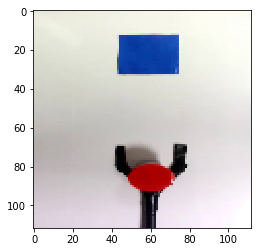

In [6]:
imagefolderpath= ('/nobackup/leopauly/IROSDataset/IROSExpDataset/Demo_push_0deg') 
print(os.path.isdir(imagefolderpath))
vids=get_compress_frames_data(imagefolderpath,normalisation=False)
print('Demo images array shape:',vids.shape)

lsp.view_image(vids[0])

In [7]:
## Splitting into clusters the video of source demonstration
x_demo = vids
x_demo_original=x_demo
x_demo =x_demo.reshape(1,x_demo.shape[0],height,width,channel)
clusters_demo=dset.clusters_with_strides(x_demo,num_clusters,cluster_length,height,width,channel,strides)

## Extraction of features
print('shape of clustered demo data:',clusters_demo.shape)
features_demo=np.zeros([num_clusters,feature_size])
for i in range(num_clusters):
    t=clusters_demo[i].reshape(1,cluster_length,height,width,channel)
    
    f_v = sess.graph.get_tensor_by_name('flatten_1/Reshape:0')
    f_v_val=np.array(sess.run([f_v], feed_dict={'conv1_input:0':t,x_image:t,K.learning_phase(): 0 }))
    
    t_f=f_v_val.reshape(-1)
    features_demo[i]= t_f   

print('shape of features from robot actions: ',features_demo.shape)

(32, 16, 112, 112, 3)
shape of clustered demo data: (32, 16, 112, 112, 3)
shape of features from robot actions:  (32, 8192)


##### Robo0 - 90 Degree

True
filenames: ['000.png', '001.png', '002.png', '003.png', '004.png', '005.png', '006.png', '007.png', '008.png', '009.png', '010.png', '011.png', '012.png', '013.png', '014.png', '015.png', '016.png', '017.png', '018.png', '019.png', '020.png', '021.png', '022.png', '023.png', '024.png', '025.png', '026.png', '027.png', '028.png', '029.png', '030.png', '031.png', '032.png', '033.png', '034.png', '035.png', '036.png', '037.png', '038.png', '039.png', '040.png', '041.png', '042.png', '043.png', '044.png', '045.png', '046.png', '047.png', '048.png', '049.png', '050.png', '051.png', '052.png', '053.png', '054.png', '055.png', '056.png', '057.png', '058.png', '059.png', '060.png', '061.png', '062.png', '063.png', '064.png', '065.png', '066.png', '067.png', '068.png', '069.png', '070.png', '071.png', '072.png', '073.png', '074.png', '075.png', '076.png', '077.png', '078.png', '079.png', '080.png', '081.png', '082.png', '083.png', '084.png', '085.png', '086.png', '087.png', '088.png', '089

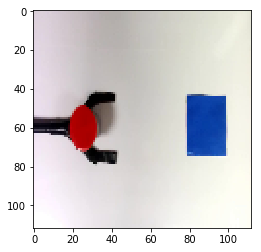

In [8]:
imagefolderpath= ('/nobackup/leopauly/IROSDataset/IROSExpDataset/Demo_push_90deg') 
print(os.path.isdir(imagefolderpath))
vids=get_compress_frames_data(imagefolderpath,normalisation=False)
print('Robo images array shape:',vids.shape)

lsp.view_image(vids[0])

In [9]:
## Splitting into & displaying clusters of target actions
x_robo=vids
x_robo_original=x_robo
x_robo =x_robo.reshape(1,x_robo.shape[0],height,width,channel)
clusters_robo=dset.clusters_with_strides(x_robo,num_clusters,cluster_length,height,width,channel,strides)

## Extracting features
print('shape of clustered robot data:',clusters_robo.shape)
features_robo=np.zeros([num_clusters,feature_size])
for i in range(num_clusters):
    t=clusters_robo[i].reshape(1,cluster_length,height,width,channel)
  
    f_v = sess.graph.get_tensor_by_name('flatten_1/Reshape:0')
    f_v_val=np.array(sess.run([f_v], feed_dict={'conv1_input:0':t,x_image:t,K.learning_phase(): 0 }))
    
    t_f=f_v_val.reshape(-1)
    features_robo[i]= t_f   

print('shape of features from robot actions: ', features_robo.shape)
print(features_robo[i])

(32, 16, 112, 112, 3)
shape of clustered robot data: (32, 16, 112, 112, 3)
shape of features from robot actions:  (32, 8192)
[ 0.          0.          0.58012843 ...,  6.03566837  5.80918455
  2.29635835]


##### Robo- 90: Colour changed

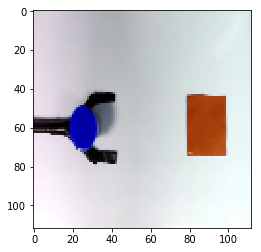

In [10]:
## Changing color
for i in range(len(vids)):
    im_=vids[i][:,:,::-1]
    vids[i]=im_
lsp.view_image(vids[0])

In [11]:
## Splitting into & displaying clusters of target actions
x_robo_coloured=vids
x_robo_coloured_original=x_robo_coloured
x_robo_coloured =x_robo_coloured.reshape(1,x_robo_coloured.shape[0],height,width,channel)
clusters_robo_coloured=dset.clusters_with_strides(x_robo_coloured,num_clusters,cluster_length,height,width,channel,strides)

## Extracting features
print('shape of clustered robot_coloured data:',clusters_robo_coloured.shape)
features_robo_coloured=np.zeros([num_clusters,feature_size])
for i in range(num_clusters):
    t=clusters_robo_coloured[i].reshape(1,cluster_length,height,width,channel)
  
    f_v = sess.graph.get_tensor_by_name('flatten_1/Reshape:0')
    f_v_val=np.array(sess.run([f_v], feed_dict={'conv1_input:0':t,x_image:t,K.learning_phase(): 0 }))
    
    t_f=f_v_val.reshape(-1)
    features_robo_coloured[i]= t_f   

print('shape of features from robot_coloured actions: ', features_robo_coloured.shape)
print(features_robo_coloured[i])

(32, 16, 112, 112, 3)
shape of clustered robot_coloured data: (32, 16, 112, 112, 3)
shape of features from robot_coloured actions:  (32, 8192)
[ 0.          0.          0.72696739 ...,  7.63502026  8.86778927
  1.02409971]


##### Robo1 - Dissimilar Dataset

True
filenames: ['00.png', '01.png', '02.png', '03.png', '04.png', '05.png', '06.png', '07.png', '08.png', '09.png', '10.png', '11.png', '12.png', '13.png', '14.png', '15.png', '16.png', '17.png', '18.png', '19.png', '20.png', '21.png', '22.png', '23.png', '24.png', '25.png', '26.png', '27.png', '28.png', '29.png', '30.png', '31.png', '32.png', '33.png', '34.png', '35.png', '36.png', '37.png', '38.png', '39.png', '40.png', '41.png', '42.png', '43.png', '44.png', '45.png', '46.png', '47.png', '48.png', '49.png', '50.png', '51.png', '52.png', '53.png', '54.png', '55.png', '56.png', '57.png', '58.png', '59.png', '60.png', '61.png', '62.png', '63.png', '64.png', '65.png', '66.png', '67.png', '68.png', '69.png', '70.png', '71.png', '72.png', '73.png', '74.png', '75.png', '76.png', '77.png', '78.png', '79.png']
Robo1 images array shape: (80, 112, 112, 3)


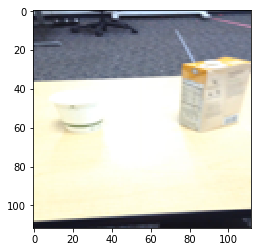

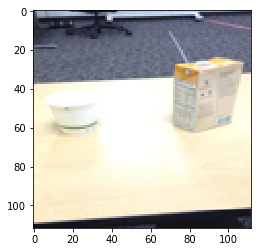

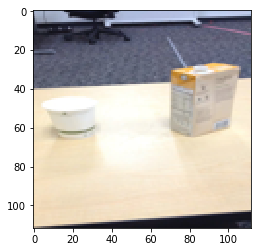

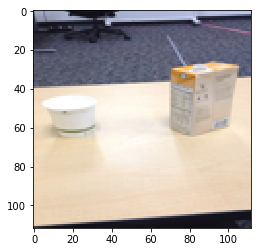

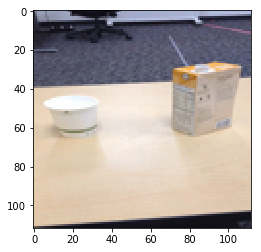

...

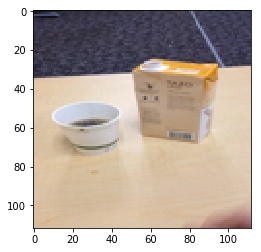

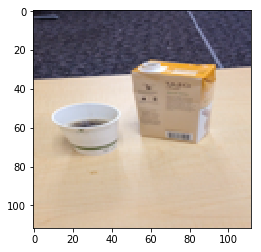

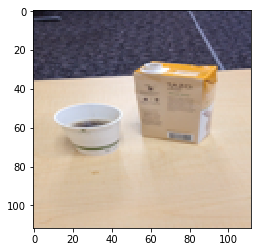

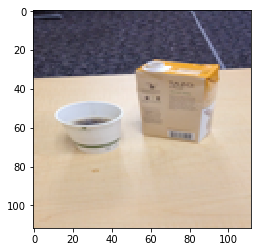

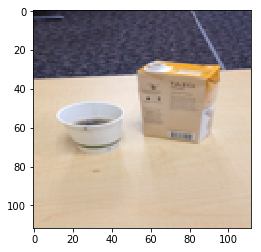

In [12]:
imagefolderpath= ('/nobackup/leopauly/IROSDataset/pour_images_new/pour0_view0') 
print(os.path.isdir(imagefolderpath))
vids=get_compress_frames_data(imagefolderpath,normalisation=False)
print('Robo1 images array shape:',vids.shape)

for i in range(len(vids)):
    plt.imshow(vids[i])
    plt.show()

In [13]:
## Splitting into & displaying clusters of target actions
x_robo1=vids
x_robo1_original=x_robo1
x_robo1 =x_robo1.reshape(1,x_robo1.shape[0],height,width,channel)
clusters_robo1=dset.clusters_with_strides(x_robo1,num_clusters,cluster_length,height,width,channel,strides)

## Extracting features
print('shape of clustered robot1 data:',clusters_robo1.shape)
features_robo1=np.zeros([num_clusters,feature_size])
for i in range(num_clusters):
    t=clusters_robo1[i].reshape(1,cluster_length,height,width,channel)
  
    f_v = sess.graph.get_tensor_by_name('flatten_1/Reshape:0')
    f_v_val=np.array(sess.run([f_v], feed_dict={'conv1_input:0':t,x_image:t,K.learning_phase(): 0 }))
    
    t_f=f_v_val.reshape(-1)
    features_robo1[i]= t_f   

print('shape of features from robot actions: ', features_robo1.shape)

(32, 16, 112, 112, 3)
shape of clustered robot1 data: (32, 16, 112, 112, 3)
shape of features from robot actions:  (32, 8192)


##### Dissimilar dataset : Colour changed

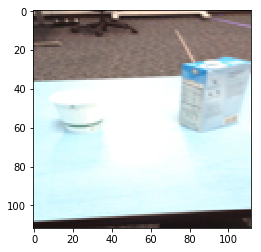

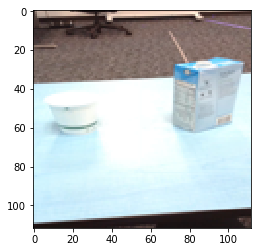

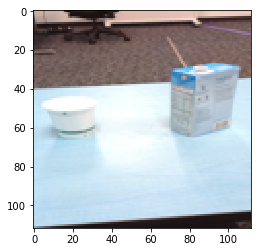

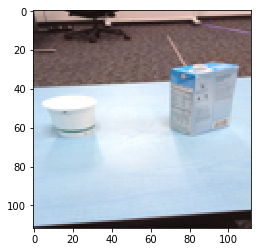

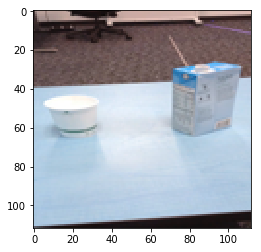

...

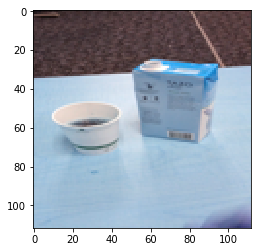

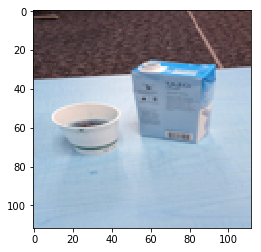

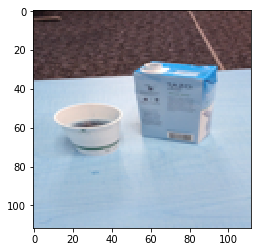

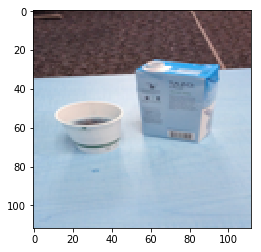

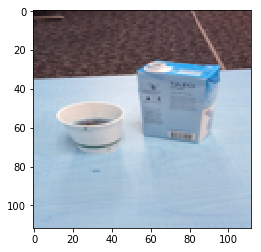

In [14]:
for i in range(len(vids)):
    im_=vids[i][:,:,::-1]
    vids[i]=im_
    
for i in range(len(vids)):
    plt.imshow(vids[i])
    plt.show()

In [15]:
## Splitting into & displaying clusters of target actions
x_robo1_coloured=vids
x_robo1_coloured_original=x_robo1_coloured
x_robo1_coloured =x_robo1_coloured.reshape(1,x_robo1_coloured.shape[0],height,width,channel)
clusters_robo1_coloured=dset.clusters_with_strides(x_robo1_coloured,num_clusters,cluster_length,height,width,channel,strides)

## Extracting features
print('shape of clustered robot1_coloured data:',clusters_robo1_coloured.shape)
features_robo1_coloured=np.zeros([num_clusters,feature_size])
for i in range(num_clusters):
    t=clusters_robo1_coloured[i].reshape(1,cluster_length,height,width,channel)
  
    f_v = sess.graph.get_tensor_by_name('flatten_1/Reshape:0')
    f_v_val=np.array(sess.run([f_v], feed_dict={'conv1_input:0':t,x_image:t,K.learning_phase(): 0 }))
    
    t_f=f_v_val.reshape(-1)
    features_robo1_coloured[i]= t_f   

print('shape of features from robot actions: ', features_robo1_coloured.shape)

(32, 16, 112, 112, 3)
shape of clustered robot1_coloured data: (32, 16, 112, 112, 3)
shape of features from robot actions:  (32, 8192)


##### Robo2 - 180 degree

True
filenames: ['000.png', '001.png', '002.png', '003.png', '004.png', '005.png', '006.png', '007.png', '008.png', '009.png', '010.png', '011.png', '012.png', '013.png', '014.png', '015.png', '016.png', '017.png', '018.png', '019.png', '020.png', '021.png', '022.png', '023.png', '024.png', '025.png', '026.png', '027.png', '028.png', '029.png', '030.png', '031.png', '032.png', '033.png', '034.png', '035.png', '036.png', '037.png', '038.png', '039.png', '040.png', '041.png', '042.png', '043.png', '044.png', '045.png', '046.png', '047.png', '048.png', '049.png', '050.png', '051.png', '052.png', '053.png', '054.png', '055.png', '056.png', '057.png', '058.png', '059.png', '060.png', '061.png', '062.png', '063.png', '064.png', '065.png', '066.png', '067.png', '068.png', '069.png', '070.png', '071.png', '072.png', '073.png', '074.png', '075.png', '076.png', '077.png', '078.png', '079.png', '080.png', '081.png', '082.png', '083.png', '084.png', '085.png', '086.png', '087.png', '088.png', '089

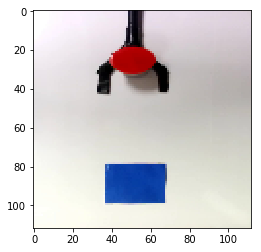

In [16]:
imagefolderpath= ('/nobackup/leopauly/IROSDataset/demo_new/Demo_push_180') 
print(os.path.isdir(imagefolderpath))
vids=get_compress_frames_data(imagefolderpath,normalisation=False)
print('Robo2 images array shape:',vids.shape)

lsp.view_image(vids[0])

In [17]:
## Splitting into & displaying clusters of target actions
x_robo2=vids
x_robo2_original=x_robo2
x_robo2 =x_robo2.reshape(1,x_robo2.shape[0],height,width,channel)
clusters_robo2=dset.clusters_with_strides(x_robo2,num_clusters,cluster_length,height,width,channel,strides)

## Extracting features
print('shape of clustered robot1 data:',clusters_robo2.shape)
features_robo2=np.zeros([num_clusters,feature_size])
for i in range(num_clusters):
    t=clusters_robo2[i].reshape(1,cluster_length,height,width,channel)
  
    f_v = sess.graph.get_tensor_by_name('flatten_1/Reshape:0')
    f_v_val=np.array(sess.run([f_v], feed_dict={'conv1_input:0':t,x_image:t,K.learning_phase(): 0 }))
    
    t_f=f_v_val.reshape(-1)
    features_robo2[i]= t_f   

print('shape of features from robot actions: ', features_robo2.shape)
print(features_robo2[i])

(32, 16, 112, 112, 3)
shape of clustered robot1 data: (32, 16, 112, 112, 3)
shape of features from robot actions:  (32, 8192)
[ 0.          1.96516025  1.4973762  ...,  2.53512287  0.          0.        ]


##### Robo2 - 180 degree : Colour changed

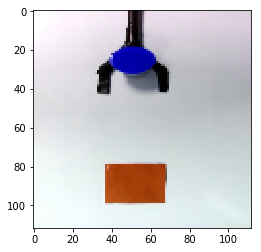

In [18]:
for i in range(len(vids)):
    im_=vids[i][:,:,::-1]
    vids[i]=im_
lsp.view_image(vids[0])

In [19]:
## Splitting into & displaying clusters of target actions
x_robo2_coloured=vids
x_robo2_coloured_original=x_robo2_coloured
x_robo2_coloured =x_robo2_coloured.reshape(1,x_robo2_coloured.shape[0],height,width,channel)
clusters_robo2_coloured=dset.clusters_with_strides(x_robo2_coloured,num_clusters,cluster_length,height,width,channel,strides)

## Extracting features
print('shape of clustered robot2_coloured data:',clusters_robo2_coloured.shape)
features_robo2_coloured=np.zeros([num_clusters,feature_size])
for i in range(num_clusters):
    t=clusters_robo2_coloured[i].reshape(1,cluster_length,height,width,channel)
  
    f_v = sess.graph.get_tensor_by_name('flatten_1/Reshape:0')
    f_v_val=np.array(sess.run([f_v], feed_dict={'conv1_input:0':t,x_image:t,K.learning_phase(): 0 }))
    
    t_f=f_v_val.reshape(-1)
    features_robo2_coloured[i]= t_f   

print('shape of features from robot actions: ', features_robo2_coloured.shape)
print(features_robo2_coloured[i])

(32, 16, 112, 112, 3)
shape of clustered robot2_coloured data: (32, 16, 112, 112, 3)
shape of features from robot actions:  (32, 8192)
[ 0.          2.24245143  3.05023599 ...,  0.91577411  0.          0.04373992]


##### Robo3 - 270 degree

True
filenames: ['000.png', '001.png', '002.png', '003.png', '004.png', '005.png', '006.png', '007.png', '008.png', '009.png', '010.png', '011.png', '012.png', '013.png', '014.png', '015.png', '016.png', '017.png', '018.png', '019.png', '020.png', '021.png', '022.png', '023.png', '024.png', '025.png', '026.png', '027.png', '028.png', '029.png', '030.png', '031.png', '032.png', '033.png', '034.png', '035.png', '036.png', '037.png', '038.png', '039.png', '040.png', '041.png', '042.png', '043.png', '044.png', '045.png', '046.png', '047.png', '048.png', '049.png', '050.png', '051.png', '052.png', '053.png', '054.png', '055.png', '056.png', '057.png', '058.png', '059.png', '060.png', '061.png', '062.png', '063.png', '064.png', '065.png', '066.png', '067.png', '068.png', '069.png', '070.png', '071.png', '072.png', '073.png', '074.png', '075.png', '076.png', '077.png', '078.png', '079.png', '080.png', '081.png', '082.png', '083.png', '084.png', '085.png', '086.png', '087.png', '088.png', '089

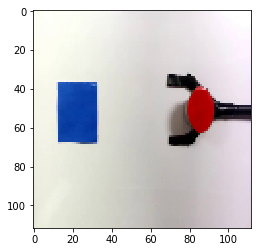

In [20]:
#imagefolderpath= ('/nobackup/leopauly/IROSDataset/IROSExpDataset/Demo_push_45deg') 
imagefolderpath= ('/nobackup/leopauly/IROSDataset/demo_new/Demo_push_270') 
print(os.path.isdir(imagefolderpath))
vids=get_compress_frames_data(imagefolderpath,normalisation=False)
print('Robo3 images array shape:',vids.shape)
lsp.view_image(vids[0])

In [21]:
## Splitting into & displaying clusters of target actions
x_robo3=vids
x_robo3_original=x_robo3
x_robo3 =x_robo3.reshape(1,x_robo3.shape[0],height,width,channel)
clusters_robo3=dset.clusters_with_strides(x_robo3,num_clusters,cluster_length,height,width,channel,strides)

## Extracting features
print('shape of clustered robot1 data:',clusters_robo3.shape)
features_robo3=np.zeros([num_clusters,feature_size])
for i in range(num_clusters):
    t=clusters_robo3[i].reshape(1,cluster_length,height,width,channel)
  
    f_v = sess.graph.get_tensor_by_name('flatten_1/Reshape:0')
    f_v_val=np.array(sess.run([f_v], feed_dict={'conv1_input:0':t,x_image:t,K.learning_phase(): 0 }))
    
    t_f=f_v_val.reshape(-1)
    features_robo3[i]= t_f   

print('shape of features from robot actions: ', features_robo3.shape)
print(features_robo3[i])

(32, 16, 112, 112, 3)
shape of clustered robot1 data: (32, 16, 112, 112, 3)
shape of features from robot actions:  (32, 8192)
[ 0.          0.          4.03611374 ...,  2.67842865  0.58778036
  3.12294674]


##### Robo3 - 270 degree - Coloured

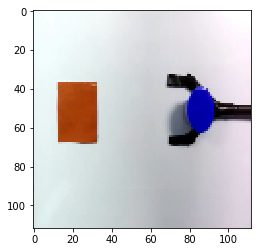

In [22]:
for i in range(len(vids)):
    im_=vids[i][:,:,::-1]
    vids[i]=im_
lsp.view_image(vids[0])

In [23]:
## Splitting into & displaying clusters of target actions
x_robo3_coloured=vids
x_robo3_coloured_original=x_robo3_coloured
x_robo3_coloured =x_robo3_coloured.reshape(1,x_robo3_coloured.shape[0],height,width,channel)
clusters_robo3_coloured=dset.clusters_with_strides(x_robo3_coloured,num_clusters,cluster_length,height,width,channel,strides)

## Extracting features
print('shape of clustered robot3_coloured data:',clusters_robo3_coloured.shape)
features_robo3_coloured=np.zeros([num_clusters,feature_size])
for i in range(num_clusters):
    t=clusters_robo3_coloured[i].reshape(1,cluster_length,height,width,channel)
  
    f_v = sess.graph.get_tensor_by_name('flatten_1/Reshape:0')
    f_v_val=np.array(sess.run([f_v], feed_dict={'conv1_input:0':t,x_image:t,K.learning_phase(): 0 }))
    
    t_f=f_v_val.reshape(-1)
    features_robo3_coloured[i]= t_f   

print('shape of features from robot3_coloured actions: ', features_robo3_coloured.shape)
print(features_robo3_coloured[i])

(32, 16, 112, 112, 3)
shape of clustered robot3_coloured data: (32, 16, 112, 112, 3)
shape of features from robot3_coloured actions:  (32, 8192)
[ 0.          0.          6.50826359 ...,  2.69857311  0.80189842
  2.86805248]


### Rewards 

#### Robo - 90 degree

In [24]:
## Calulating distance
distance=np.zeros([num_clusters,feature_size])
reward=np.zeros([num_clusters,1])
for i in range(num_clusters):
    distance[i] = features_demo[i]-features_robo[i]
    reward[i]=-(np.linalg.norm(distance[i]))
print(reward[0:5])
print(distance[0:5])

[[-523.87140146]
 [-521.5262037 ]
 [-517.91468074]
 [-512.99648825]
 [-507.75306519]]
[[ 0.          0.19744153  0.82932848 ..., -3.60440969 -3.35700846
   4.43036699]
 [ 0.          0.24319686  0.92027646 ..., -3.63751578 -3.4116497
   4.42500496]
 [ 0.          0.3371557   1.02521133 ..., -3.85644865 -3.39120841
   4.32571745]
 [ 0.          0.48331654  1.04443765 ..., -4.05392194 -3.13772151
   4.24747658]
 [ 0.          0.63330996  0.90031345 ..., -4.25724792 -2.79373124
   4.18722105]]


In [25]:
## Calulating distance
distance=np.zeros([num_clusters,feature_size])
reward_coloured=np.zeros([num_clusters,1])
for i in range(num_clusters):
    distance[i] = features_demo[i]-features_robo_coloured[i]
    reward_coloured[i]=-(np.linalg.norm(distance[i]))
print(reward_coloured[0:5])
print(distance[0:5])

[[-530.23526883]
 [-527.17216063]
 [-523.18996536]
 [-519.40991238]
 [-515.5705556 ]]
[[ 0.          0.19744153 -0.39548105 ..., -4.75218868 -5.27485132
   4.43036699]
 [ 0.          0.24319686 -0.78624052 ..., -4.81822276 -5.33655262
   4.42500496]
 [ 0.          0.3371557  -1.07481217 ..., -5.17056799 -5.36050463
   4.32571745]
 [ 0.          0.48331654 -1.22174025 ..., -5.49887729 -5.25152776
   4.24747658]
 [ 0.          0.63330996 -1.79457748 ..., -5.78340101 -4.92596415
   4.18722105]]


#### Robo 1 - Dissimilar

In [26]:
## Calulating distance
distance=np.zeros([num_clusters,feature_size])
reward1=np.zeros([num_clusters,1])
for i in range(num_clusters):
    distance[i] = features_demo[i]-features_robo1[i]
    reward1[i]=-(np.linalg.norm(distance[i]))
print(reward1[0:5])
print(distance[0:5])

[[-465.83679882]
 [-474.59176975]
 [-479.63735619]
 [-484.2092893 ]
 [-487.37494461]]
[[-5.96987391 -4.81281953 -2.41156918 ...,  1.62388659 -1.89746177
  -4.41089392]
 [-4.71351433 -4.0674182  -2.09285897 ...,  1.87192214 -2.61789274
  -4.76834488]
 [-3.11806488 -2.9115063  -2.11549616 ...,  1.65349168 -2.99536943
  -4.90296221]
 [-1.42549479 -1.52893102 -1.92140841 ...,  1.23438954 -3.10043094
  -4.87038136]
 [-0.36482209  0.09216166 -0.97831285 ...,  0.86635017 -2.50447467
  -4.48523283]]


#### Robo 1 - Dissimilar : Coloured

In [27]:
## Calulating distance
distance=np.zeros([num_clusters,feature_size])
reward1_coloured=np.zeros([num_clusters,1])
for i in range(num_clusters):
    distance[i] = features_demo[i]-features_robo1_coloured[i]
    reward1_coloured[i]=-(np.linalg.norm(distance[i]))
print(reward1_coloured[0:5])
print(distance[0:5])

[[-495.81171591]
 [-499.87630035]
 [-502.45161204]
 [-503.86588002]
 [-503.45858826]]
[[-3.86807132 -4.1307507  -1.82207495 ...,  2.60383195 -1.59291482
   4.43036699]
 [-3.44553041 -3.58159195 -2.18638939 ...,  1.11421764 -1.91320825
   4.42500496]
 [-1.81329966 -2.64791715 -2.76044011 ...,  0.71248162 -1.78078973
   4.32571745]
 [-0.47715905 -1.20778239 -2.77399135 ...,  0.90726602 -0.88479421
   4.24747658]
 [ 0.          0.4139121  -2.48993647 ...,  1.24457592  0.09752876
   4.18722105]]


#### Robo 2 - 180 degree

In [28]:
## Calulating distance
distance=np.zeros([num_clusters,feature_size])
reward2=np.zeros([num_clusters,1])
for i in range(num_clusters):
    distance[i] = features_demo[i]-features_robo2[i]
    reward2[i]=-(np.linalg.norm(distance[i]))
print(reward2[0:5])
print(distance[0:5])

[[-445.40264238]
 [-450.03219644]
 [-453.65376166]
 [-457.05657829]
 [-457.93453013]]
[[ 0.         -1.28537826 -8.37356383 ...,  1.57059395  0.          2.36131477]
 [ 0.         -0.38091819 -7.94699496 ...,  1.44028223  0.          2.46051097]
 [ 0.          0.3371557  -7.5805521  ...,  1.15989161  0.          2.46571493]
 [ 0.          0.48331654 -7.15536666 ...,  0.93515146  0.1636391
   2.44019759]
 [ 0.          0.63330996 -6.520347   ...,  0.76409233  0.48739263
   2.34347761]]


#### Robo 2 - 180 degree : Coloured

In [29]:
## Calulating distance
distance=np.zeros([num_clusters,feature_size])
reward2_coloured=np.zeros([num_clusters,1])
for i in range(num_clusters):
    distance[i] = features_demo[i]-features_robo2_coloured[i]
    reward2_coloured[i]=-(np.linalg.norm(distance[i]))
print(reward2_coloured[0:5])
print(distance[0:5])

[[-392.82319904]
 [-398.05004239]
 [-402.43803915]
 [-406.69630582]
 [-409.86527333]]
[[ 0.          0.16129628 -6.71520382 ...,  2.16757977  0.          2.5860914 ]
 [ 0.          0.24319686 -6.64762086 ...,  2.08016306  0.          2.50372899]
 [ 0.          0.3371557  -6.36603308 ...,  1.73459381  0.          2.35218465]
 [-0.00793658  0.48331654 -6.82919049 ...,  1.52017939  0.1636391
   2.27400136]
 [-0.0509625   0.63330996 -6.49554288 ...,  1.39918947  0.48739263
   2.22253084]]


#### Robo 3- 270 degree

In [30]:
## Calulating distance
distance=np.zeros([num_clusters,feature_size])
reward3=np.zeros([num_clusters,1])
for i in range(num_clusters):
    distance[i] = features_demo[i]-features_robo3[i]
    reward3[i]=-(np.linalg.norm(distance[i]))
print(reward3[0:5])
print(distance[0:5])

[[-528.29213823]
 [-527.03438082]
 [-523.79401854]
 [-519.58848472]
 [-514.69023948]]
[[ 0.          0.19744153  0.82932848 ..., -0.16974902 -1.35826921
   2.60543454]
 [ 0.          0.24319686  0.92027646 ..., -0.08453774 -1.23210907
   2.53296638]
 [ 0.          0.3371557   1.02521133 ..., -0.25089455 -1.1348927
   2.3212297 ]
 [ 0.          0.48331654  1.04443765 ..., -0.29871607 -0.89656863
   2.18260193]
 [ 0.          0.63330996  1.13011372 ..., -0.25658035 -0.64833465
   2.2136941 ]]


#### Robo 3- 270 degree : Coloured

In [31]:
## Calulating distance
distance=np.zeros([num_clusters,feature_size])
reward3_coloured=np.zeros([num_clusters,1])
for i in range(num_clusters):
    distance[i] = features_demo[i]-features_robo3_coloured[i]
    reward3_coloured[i]=-(np.linalg.norm(distance[i]))
print(reward3_coloured[0:5])
print(distance[0:5])

[[-532.20417717]
 [-529.62094464]
 [-525.43439135]
 [-521.34737283]
 [-516.51530953]]
[[ 0.          0.19744153 -1.4860552  ..., -0.4669323  -1.70738995
   3.19596386]
 [ 0.          0.24319686 -1.23813337 ..., -0.48375964 -1.59140873
   2.9386251 ]
 [ 0.          0.3371557  -1.07532597 ..., -0.61689234 -1.42850268
   2.56083763]
 [ 0.          0.48331654 -1.07841086 ..., -0.72094369 -1.16091463
   2.36345553]
 [ 0.          0.63330996 -1.07138121 ..., -0.78569078 -0.94444624
   2.35949373]]


#### Plotting

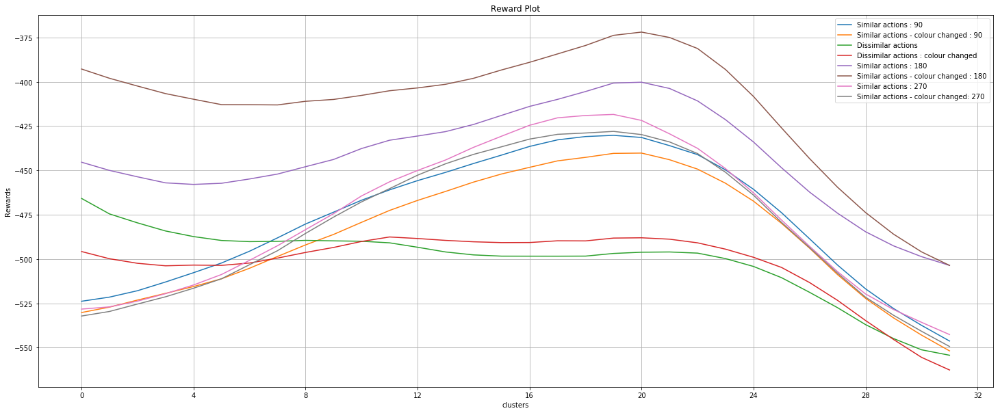

In [32]:
y_values=list(range(num_clusters))
plt.figure(figsize=(25,10))
plt.xlabel('clusters')
plt.ylabel('Rewards')
plt.grid(True)
plt.gca().xaxis.set_major_locator(MaxNLocator(integer=True))
plt.title('Reward Plot')
line,=plt.plot(y_values,reward,label='Similar actions : 90')
line_coloured,=plt.plot(y_values,reward_coloured,label='Similar actions - colour changed : 90')
line1,=plt.plot(y_values,reward1,label='Dissimilar actions')
line1_coloured,=plt.plot(y_values,reward1_coloured,label='Dissimilar actions : colour changed')
line2,=plt.plot(y_values,reward2,label='Similar actions : 180')
line2_coloured,=plt.plot(y_values,reward2_coloured,label='Similar actions - colour changed : 180')
line3,=plt.plot(y_values,reward3,label='Similar actions : 270')
line3_coloured,=plt.plot(y_values,reward3_coloured,label='Similar actions - colour changed: 270')
plt.legend(handles=[line,line_coloured, line1,line1_coloured,line2,line2_coloured,line3,line3_coloured])
plt.show()
#lsp.plot_values_with_legends(y_values,reward,'reward','clusters','value','reward function',color='red',ylim=True)ß

### Display

#### All videos

#### Showing clusters

cluster no:  0


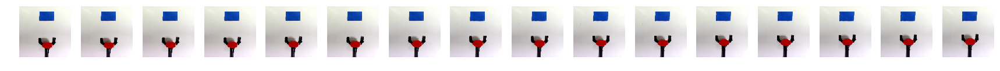

cluster no:  1


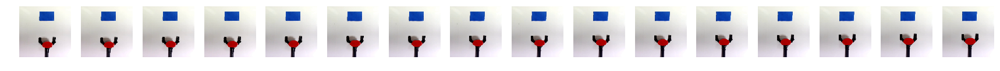

cluster no:  2


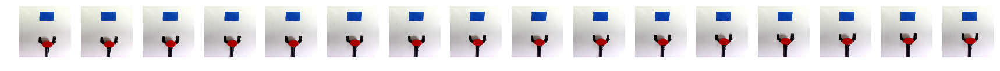

cluster no:  3


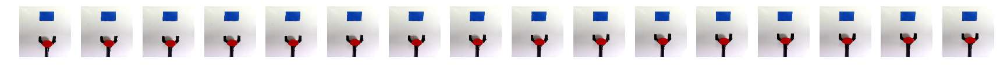

cluster no:  4


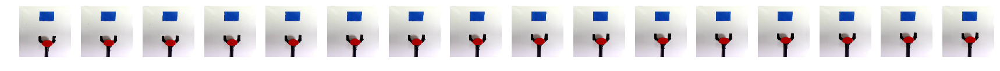

cluster no:  5


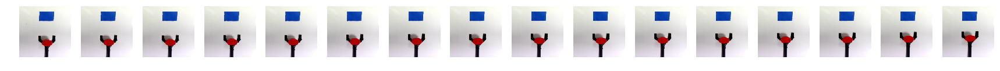

cluster no:  6


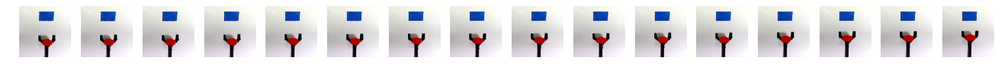

cluster no:  7


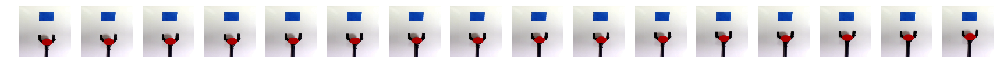

cluster no:  8


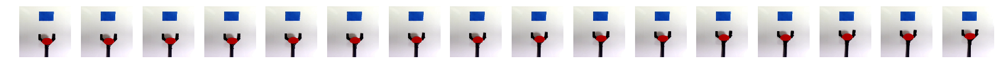

cluster no:  9


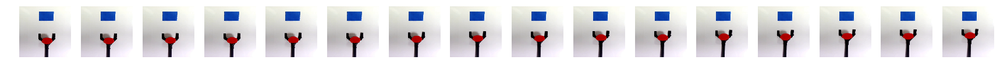

cluster no:  10


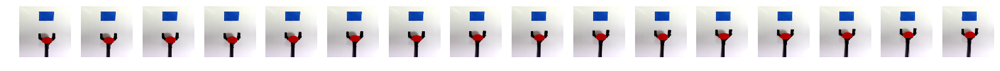

cluster no:  11


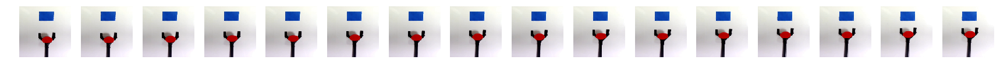

cluster no:  12


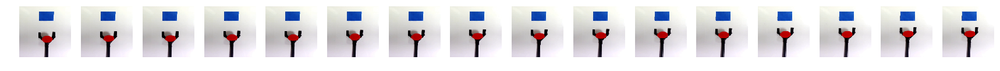

cluster no:  13


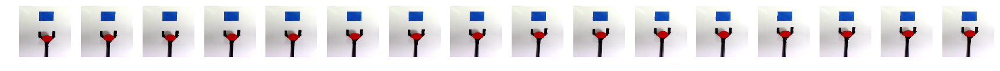

cluster no:  14


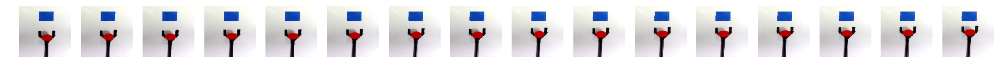

cluster no:  15


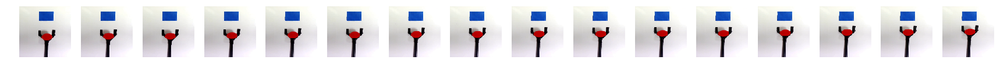

cluster no:  16


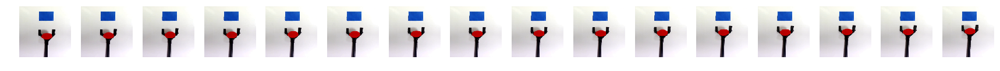

cluster no:  17


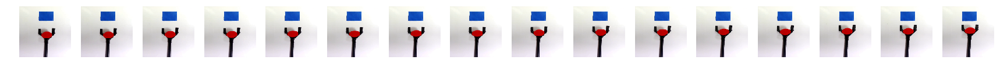

cluster no:  18


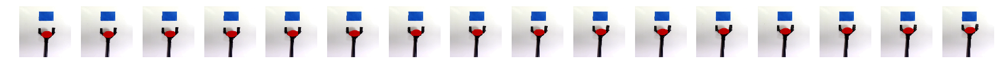

cluster no:  19


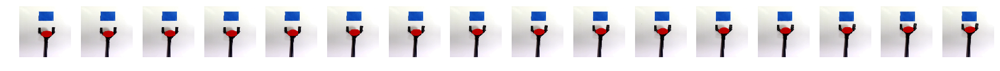

cluster no:  20


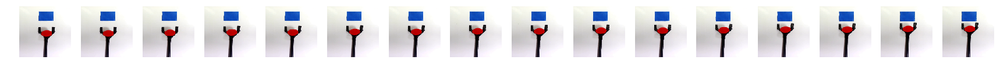

cluster no:  21


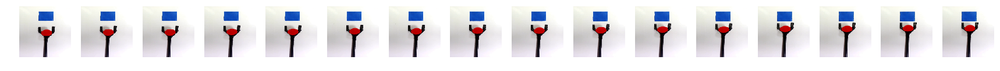

cluster no:  22


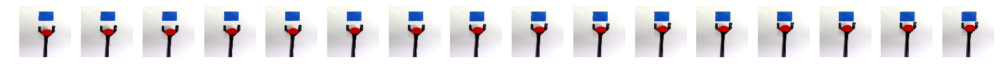

cluster no:  23


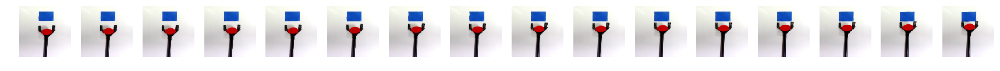

cluster no:  24


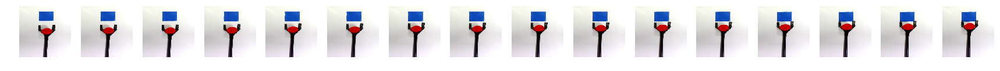

cluster no:  25


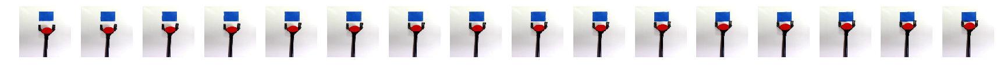

cluster no:  26


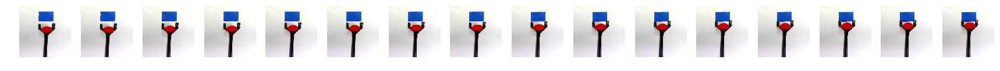

cluster no:  27


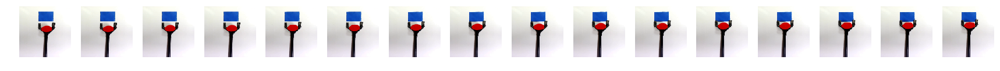

cluster no:  28


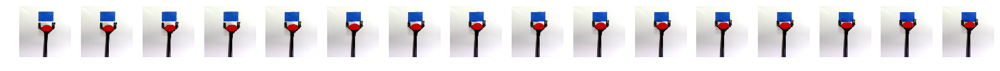

cluster no:  29


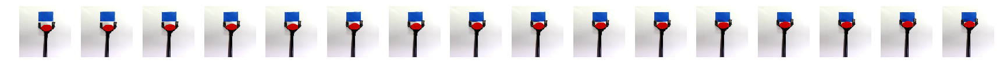

cluster no:  30


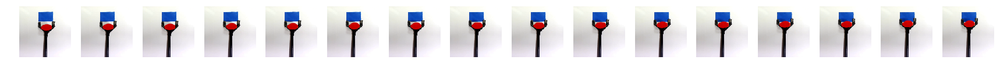

cluster no:  31


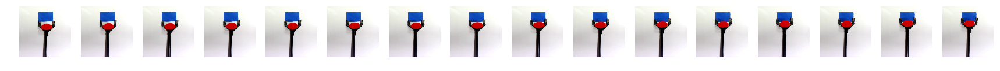

In [33]:
y_=np.zeros([1])
## Clusters from demos
for i in range(num_clusters):
    cluster_id=i
    y_d=np.repeat(y_,num_clusters)
    print('cluster no: ',i)
    display=clusters_demo#.reshape(clusters_demo.shape[0],clusters_demo.shape[1],clusters_demo.shape[2],clusters_demo.shape[3],clusters_demo.shape[4])
    lsp.view_video_inline(display,y_d,cluster_length,cluster_id)

cluster no:  0


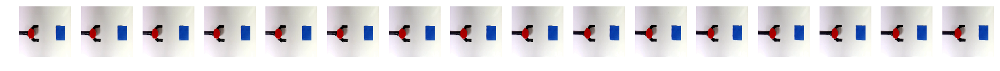

cluster no:  1


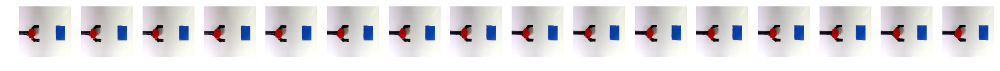

cluster no:  2


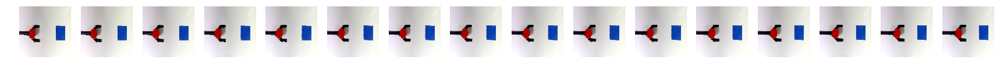

cluster no:  3


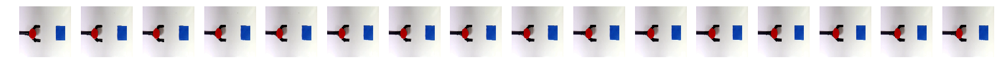

cluster no:  4


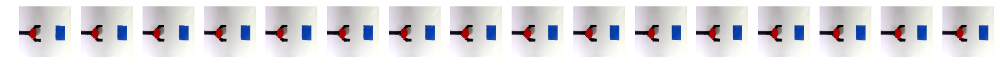

cluster no:  5


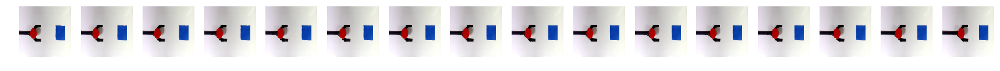

cluster no:  6


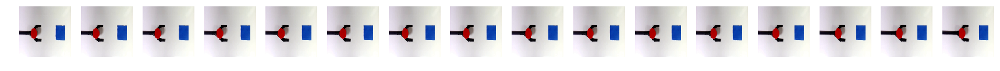

cluster no:  7


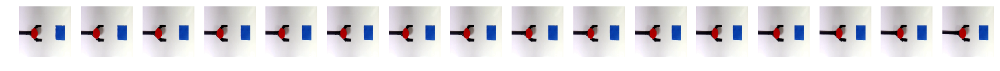

cluster no:  8


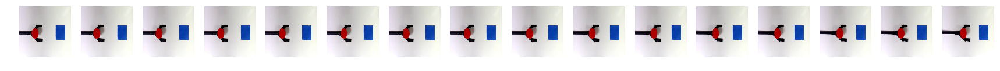

cluster no:  9


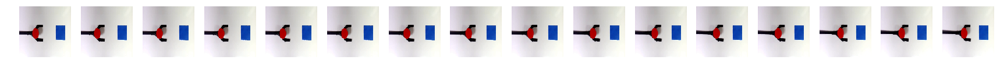

cluster no:  10


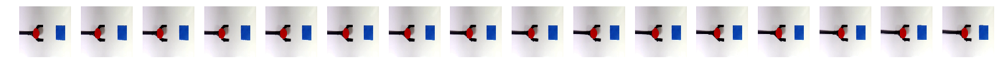

cluster no:  11


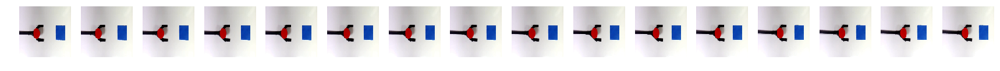

cluster no:  12


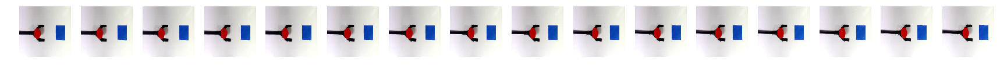

cluster no:  13


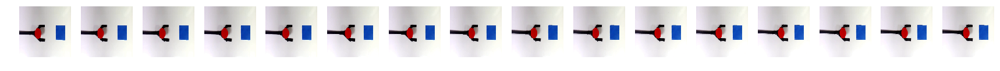

cluster no:  14


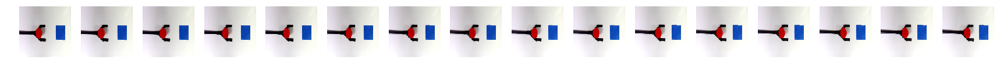

cluster no:  15


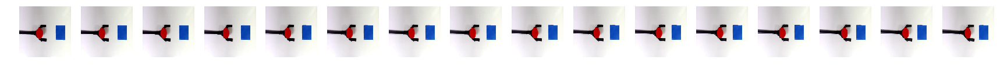

cluster no:  16


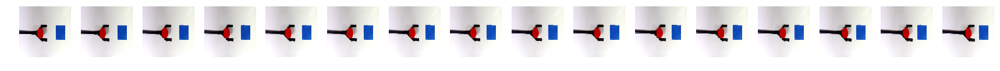

cluster no:  17


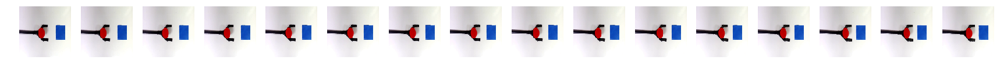

cluster no:  18


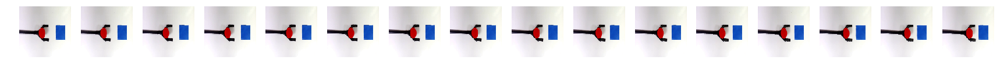

cluster no:  19


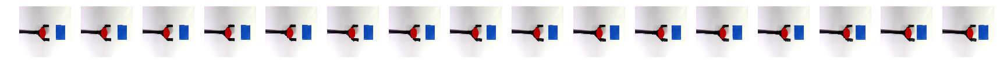

cluster no:  20


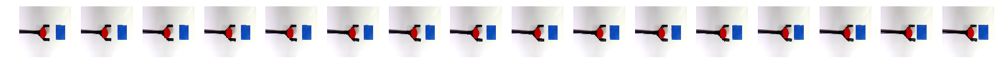

cluster no:  21


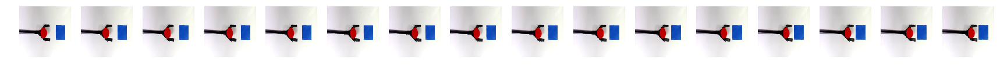

cluster no:  22


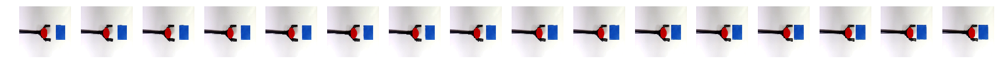

cluster no:  23


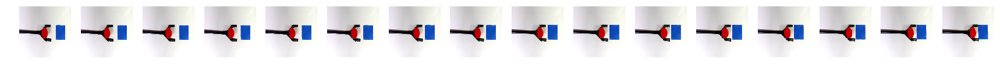

cluster no:  24


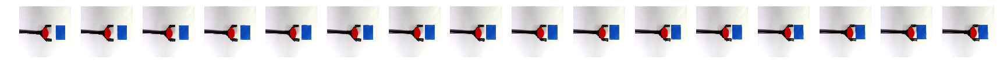

cluster no:  25


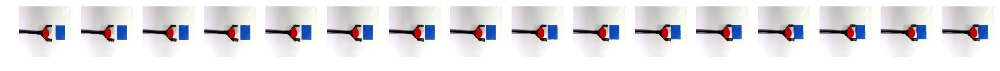

cluster no:  26


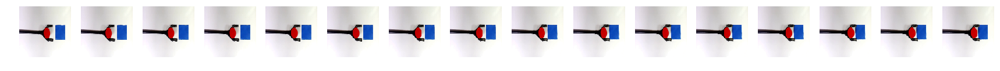

cluster no:  27


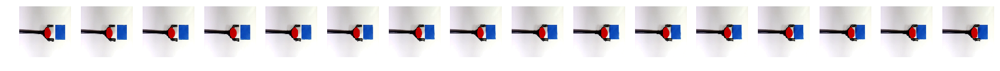

cluster no:  28


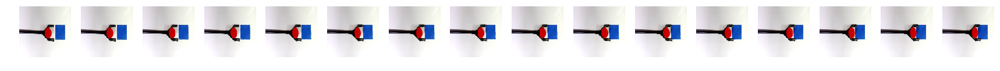

cluster no:  29


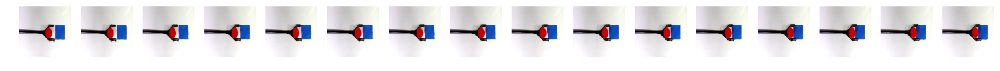

cluster no:  30


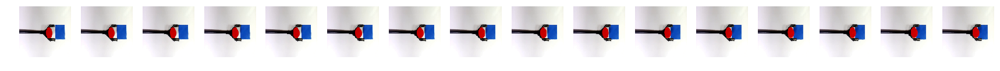

cluster no:  31


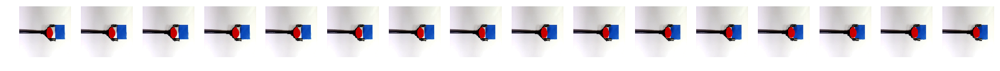

In [34]:
## Clusters from robot action
y_r=np.repeat(y_,num_clusters)
for i in range(num_clusters):
    cluster_id=i 
    print('cluster no: ',i)
    display=clusters_robo.reshape(clusters_robo.shape[0],clusters_robo.shape[1],clusters_robo.shape[2],clusters_robo.shape[3],clusters_robo.shape[4])
    lsp.view_video_inline(display,y_r,cluster_length,cluster_id)

cluster no:  0


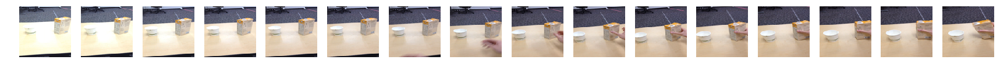

cluster no:  1


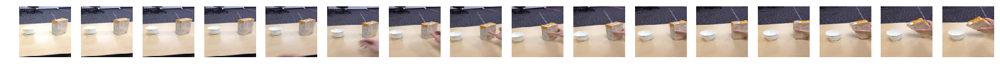

cluster no:  2


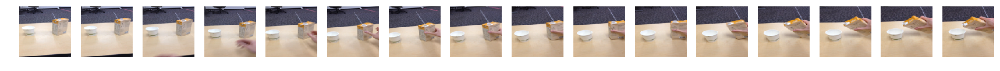

cluster no:  3


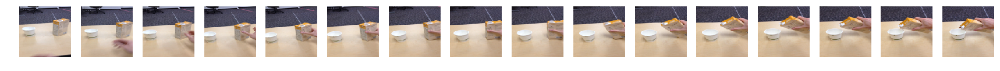

cluster no:  4


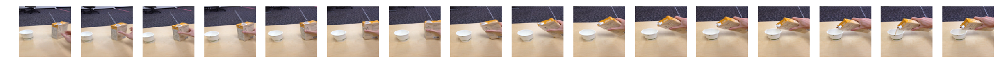

cluster no:  5


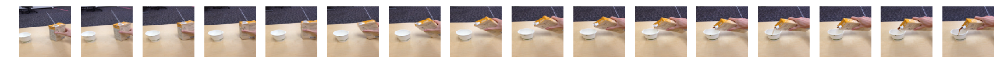

cluster no:  6


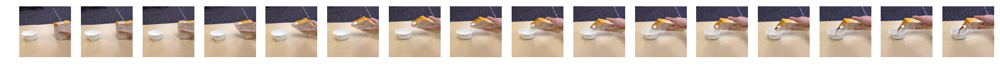

cluster no:  7


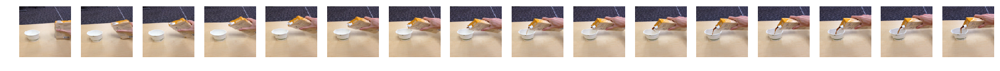

cluster no:  8


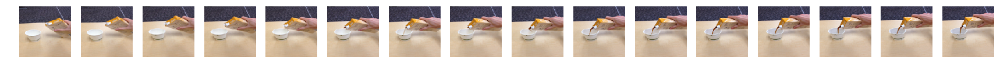

cluster no:  9


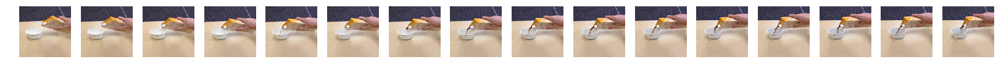

cluster no:  10


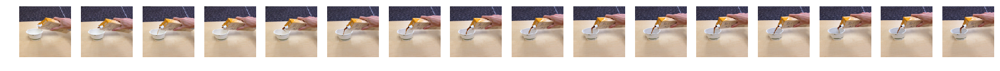

cluster no:  11


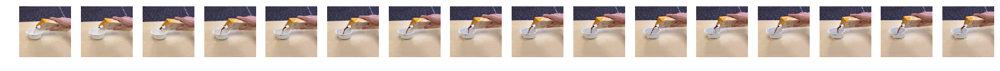

cluster no:  12


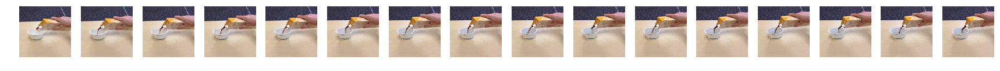

cluster no:  13


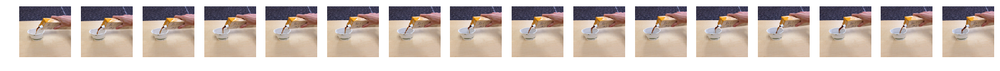

cluster no:  14


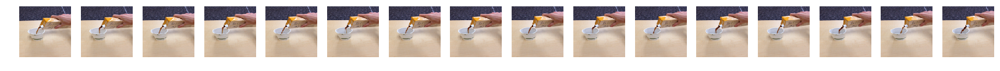

cluster no:  15


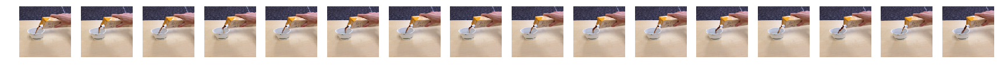

cluster no:  16


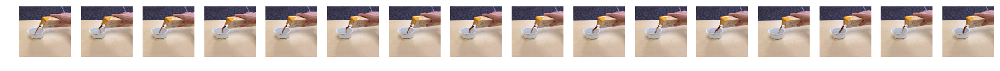

cluster no:  17


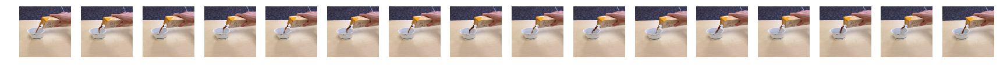

cluster no:  18


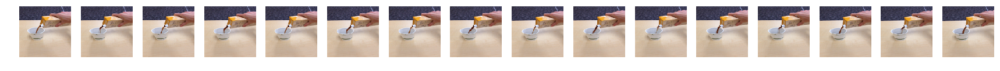

cluster no:  19


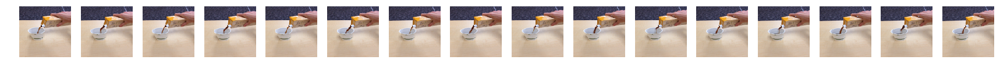

cluster no:  20


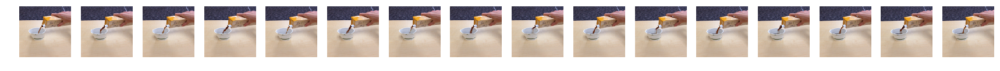

cluster no:  21


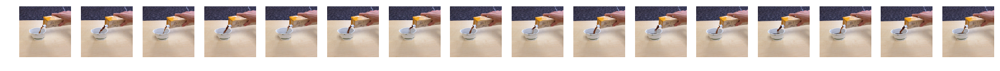

cluster no:  22


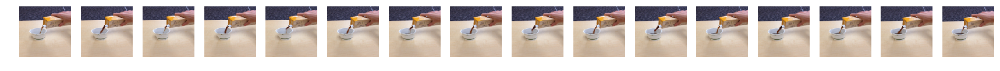

cluster no:  23


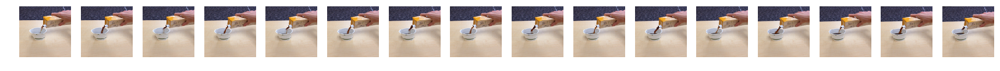

cluster no:  24


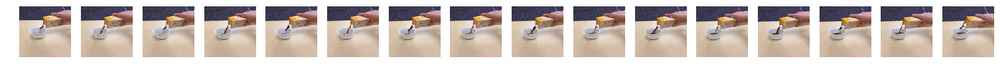

cluster no:  25


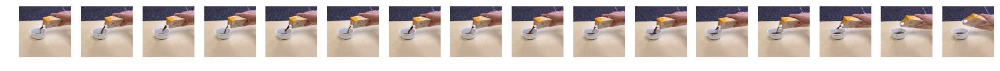

cluster no:  26


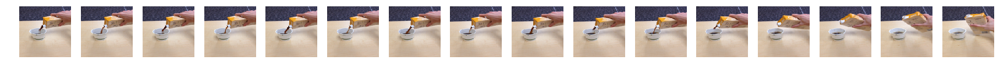

cluster no:  27


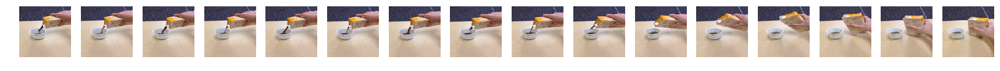

cluster no:  28


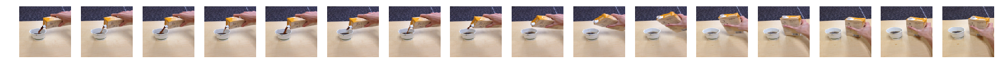

cluster no:  29


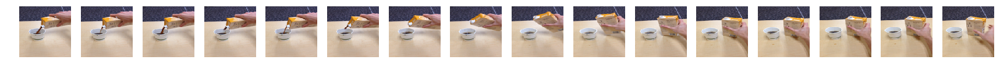

cluster no:  30


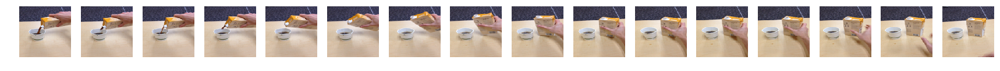

cluster no:  31


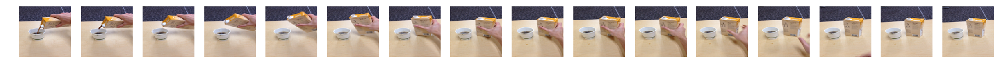

In [35]:
## Clusters from robot1 action
y_r=np.repeat(y_,num_clusters)
for i in range(num_clusters):
    cluster_id=i 
    print('cluster no: ',i)
    display=clusters_robo1
    lsp.view_video_inline(display,y_r,cluster_length,cluster_id)

cluster no:  0


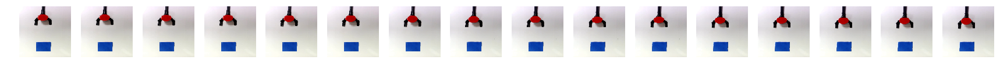

cluster no:  1


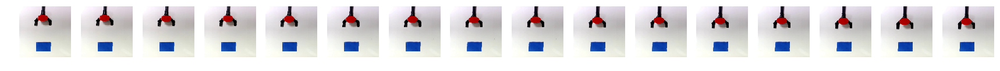

cluster no:  2


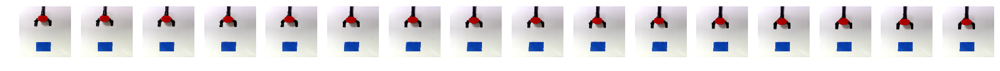

cluster no:  3


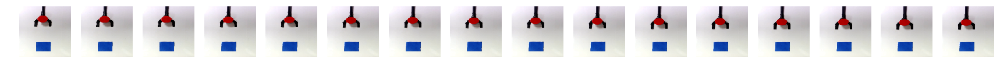

cluster no:  4


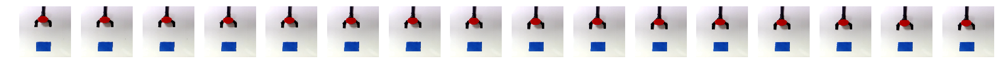

cluster no:  5


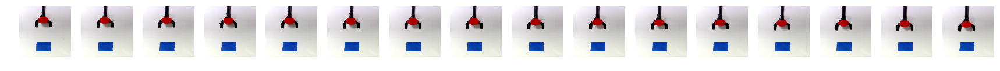

cluster no:  6


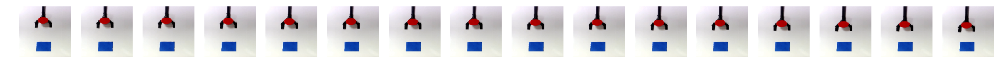

cluster no:  7


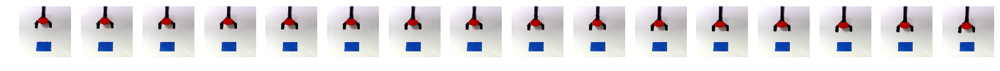

cluster no:  8


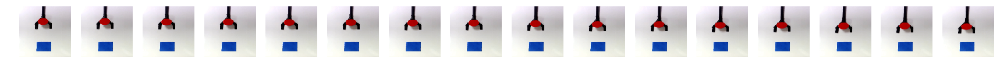

cluster no:  9


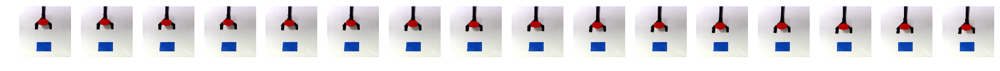

cluster no:  10


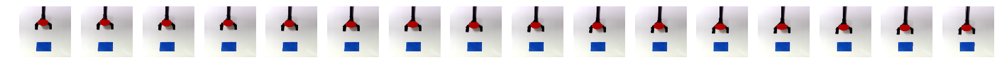

cluster no:  11


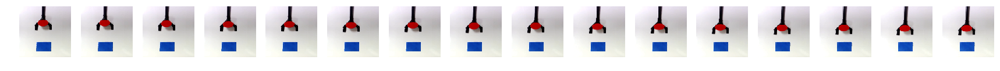

cluster no:  12


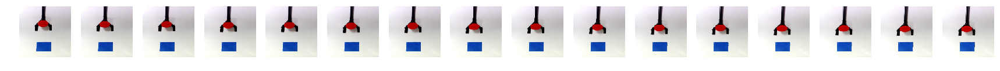

cluster no:  13


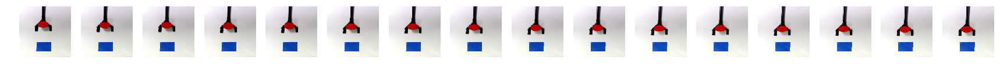

cluster no:  14


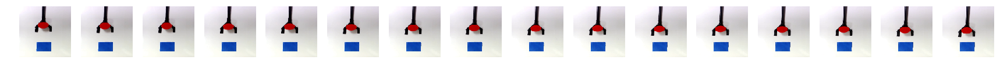

cluster no:  15


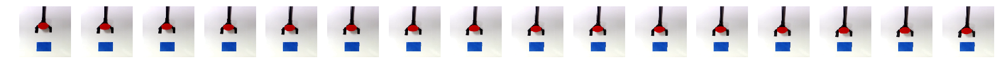

cluster no:  16


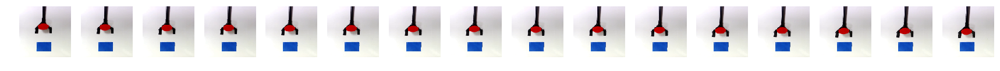

cluster no:  17


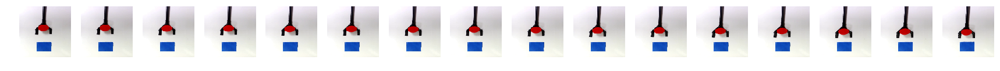

cluster no:  18


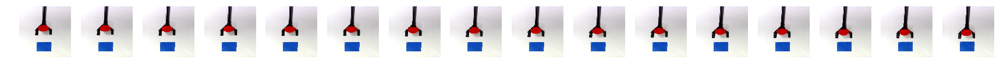

cluster no:  19


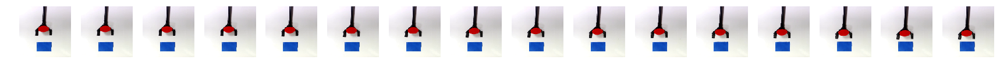

cluster no:  20


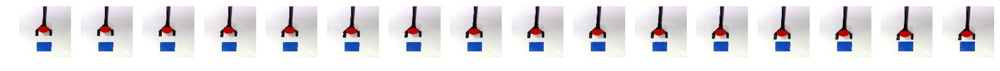

cluster no:  21


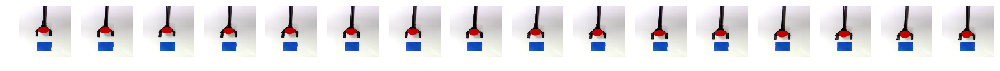

cluster no:  22


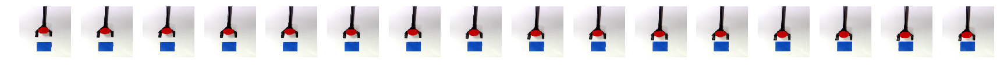

cluster no:  23


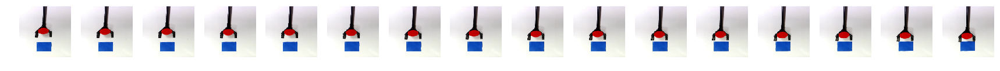

cluster no:  24


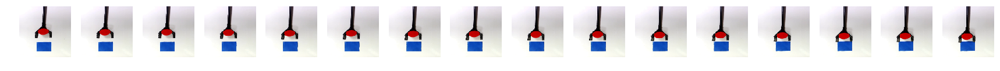

cluster no:  25


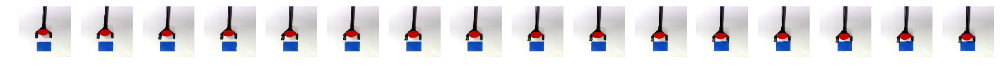

cluster no:  26


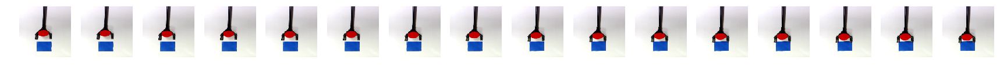

cluster no:  27


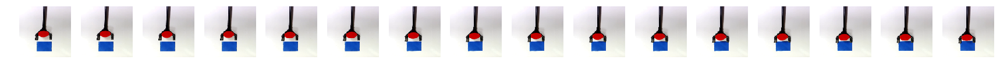

cluster no:  28


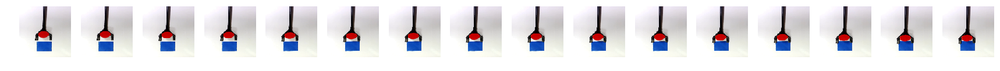

cluster no:  29


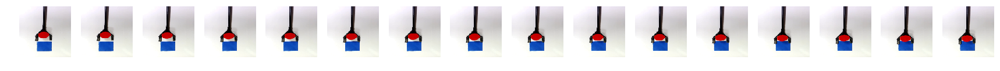

cluster no:  30


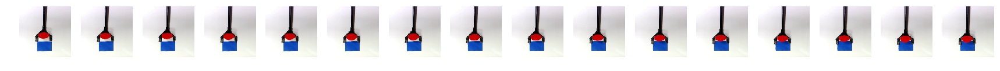

cluster no:  31


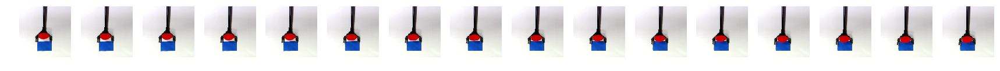

In [ ]:
## Clusters from robot1 action
y_r=np.repeat(y_,num_clusters)
for i in range(num_clusters):
    cluster_id=i 
    print('cluster no: ',i)
    display=clusters_robo2
    lsp.view_video_inline(display,y_r,cluster_length,cluster_id)

cluster no:  0


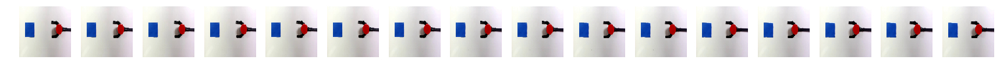

cluster no:  1


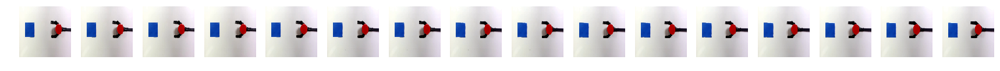

cluster no:  2


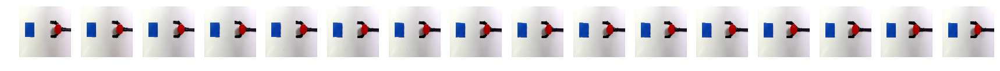

cluster no:  3


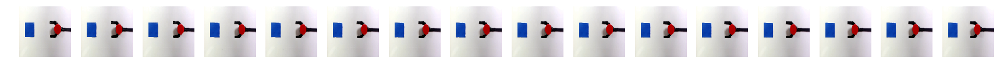

cluster no:  4


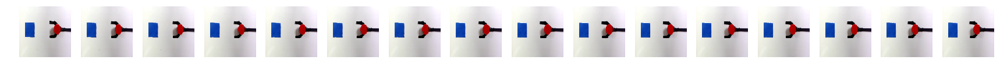

cluster no:  5


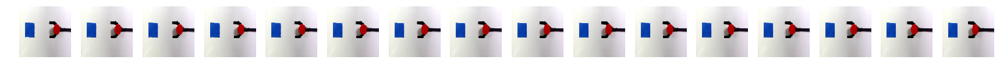

cluster no:  6


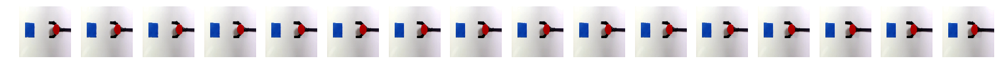

cluster no:  7


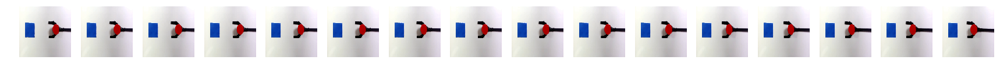

cluster no:  8


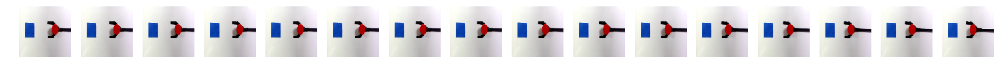

cluster no:  9


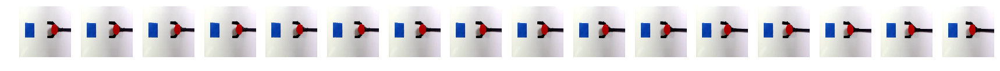

cluster no:  10


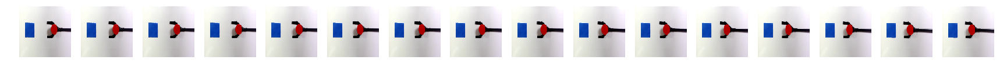

cluster no:  11


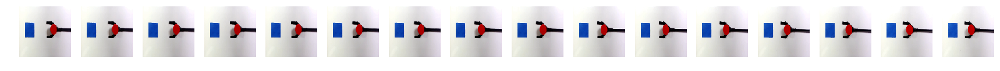

cluster no:  12


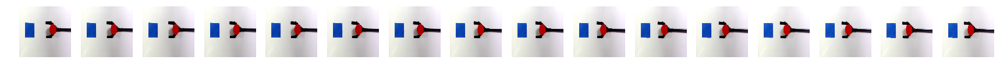

cluster no:  13


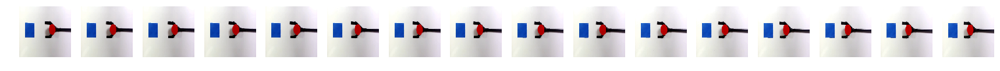

cluster no:  14


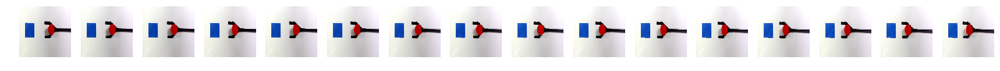

cluster no:  15


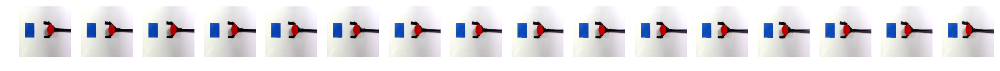

cluster no:  16


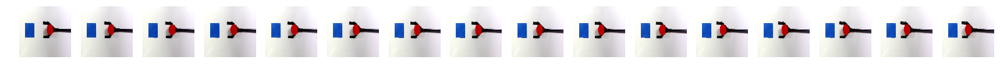

cluster no:  17


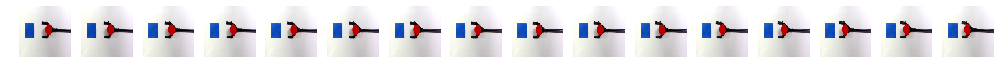

cluster no:  18


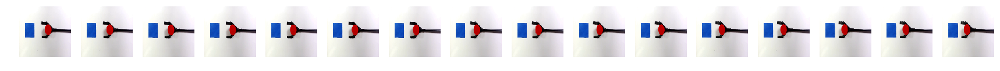

cluster no:  19


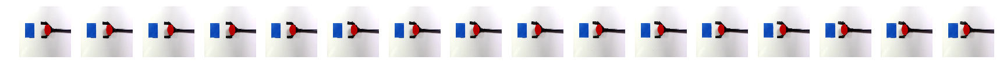

cluster no:  20


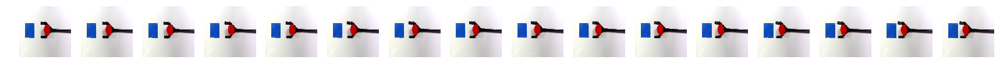

cluster no:  21


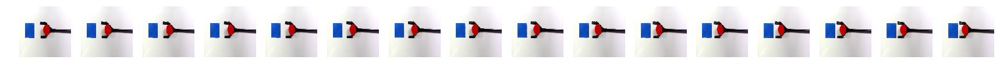

cluster no:  22


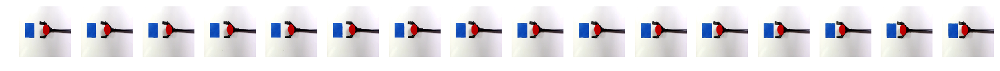

cluster no:  23


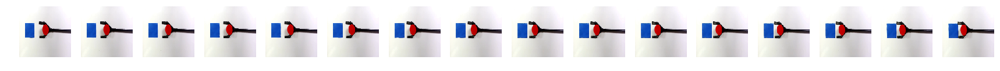

cluster no:  24


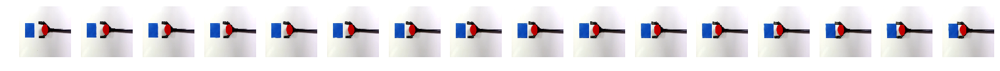

cluster no:  25


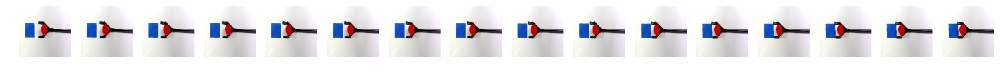

cluster no:  26


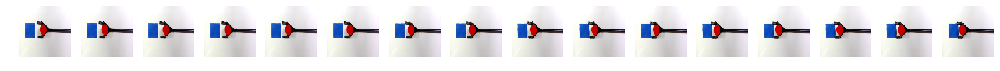

cluster no:  27


In [ ]:
## Clusters from robot1 action
y_r=np.repeat(y_,num_clusters)
for i in range(num_clusters):
    cluster_id=i 
    print('cluster no: ',i)
    display=clusters_robo3
    lsp.view_video_inline(display,y_r,cluster_length,cluster_id)